# Data Project: Linear Regression
## Goals of this project:
    1. find some open data and import it to a dataframe
    2. explore the data, examine it for missing values, why are they missing?, how can this be solved?
    3. find what to model and see whether it seems like a realistic relationship
    4. create some features that can assist in the prediction of the model 
        -- is there any categorical data that would make a suitable dummy variable?
        -- is there any data that could be used as an instrumental variable?
    5. Begin modeling
    6. Evaluate the model


#### Resources Used:
- [Winemag Data From Kaggle](https://www.kaggle.com/zynicide/wine-reviews)
- Relevant module documentation: pandas, numpy, matplotlib, seaborn, sklearn, statsmodels.api
- [A Video that helped me understand pandas](https://www.youtube.com/watch?v=vmEHCJofslg)
- [My inspiration for the project](https://www.youtube.com/playlist?list=PL2zq7klxX5ASFejJj80ob9ZAnBHdz5O1t)
- [A snippit of code to evaluate Sklearns models](https://stackoverflow.com/questions/26319259/how-to-get-a-regression-summary-in-python-scikit-like-r-does)
- [Memory Troubleshooting](https://stackoverflow.com/questions/57507832/unable-to-allocate-array-with-shape-and-data-type)
- [Using pip install with multiple versions of python installed](https://stackoverflow.com/questions/34803040/how-to-run-pip-of-different-version-of-python-using-python-command)


In [41]:
# importing libraries needed to do most of the data exploration and analysis
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

plt.style.use('seaborn')
# setting random seed for consistency
np.random.seed(0)





## Data Exploration




In [133]:
wine = pd.read_csv('winemag-data-130k-v2.csv', index_col=0)
wine.head()

,country,description,designation,points,price,province,region_1,region_2,taster_name,taster_twitter_handle,title,variety,winery
0,Italy,"Aromas include tropical fruit, broom, brimston...",Vulkà Bianco,87,NaN,Sicily & Sardinia,Etna,NaN,Kerin O’Keefe,@kerinokeefe,Nicosia 2013 Vulkà Bianco (Etna),White Blend,Nicosia
1,Portugal,"This is ripe and fruity, a wine that is smooth...",Avidagos,87,15.0,Douro,NaN,NaN,Roger Voss,@vossroger,Quinta dos Avidagos 2011 Avidagos Red (Douro),Portuguese Red,Quinta dos Avidagos
2,US,"Tart and snappy, the flavors of lime flesh and...",NaN,87,14.0,Oregon,Willamette Valley,Willamette Valley,Paul Gregutt,@paulgwine,Rainstorm 2013 Pinot Gris (Willamette Valley),Pinot Gris,Rainstorm
3,US,"Pineapple rind, lemon pith and orange blossom ...",Reserve Late Harvest,87,13.0,Michigan,Lake Michigan Shore,NaN,Alexander Peartree,NaN,St. Julian 2013 Reserve Late Harvest Riesling ...,Riesling,St. Julian
4,US,"Much like the regular bottling from 2012, this...",Vintner's Reserve Wild Child Block,87,65.0,Oregon,Willamette Valley,Willamette Valley,Paul Gregutt,@paulgwine,Sweet Cheeks 2012 Vintner's Reserve Wild Child...,Pinot Noir,Sweet Cheeks


In [43]:
# Can use the winery and variety as well as points to work as proxies for price prediction, Points is a continuous attribute whereas winery and variety
# will have to be dummy variables, will have to test their ability to predict, value_counts shows that only a few wineries produce multiple wines
# and only a few varieties have many wines

wine.winery.value_counts()
wine.variety.value_counts()

top_wine_countries = wine[wine.points==100].country.value_counts()

point_count = wine.points.value_counts()
sorted_point_count = point_count.sort_index(ascending=True)
sorted_point_count

80       397
81       692
82      1836
83      3025
84      6480
85      9530
86     12600
87     16933
88     17207
89     12226
90     15410
91     11359
92      9613
93      6489
94      3758
95      1535
96       523
97       229
98        77
99        33
100       19
Name: points, dtype: int64

In [44]:
# Looking at correlation matrix, decent positive correlation between points and price
wine.corr()

,points,price
points,1.000000,0.416167
price,0.416167,1.000000


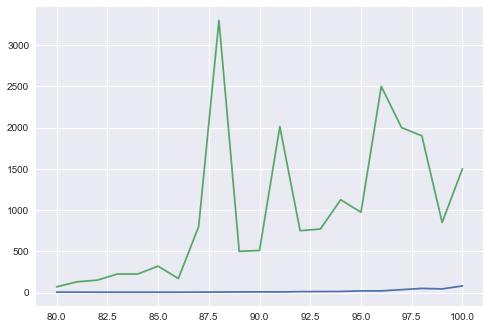

In [45]:
# Finding the lowest price wine and highest price wine at each point value and plotting them against eachother, The min value seems to follow
# a sensible, slight upwards price trend but the max is most likely being influenced by outliers

price_point_range = wine.groupby('points').price.agg([min, max])
plt.plot(price_point_range)

In [46]:
# Highest price wine in the dataset -- Likely outlier
wine[wine.price==3300]

,country,description,designation,points,price,province,region_1,region_2,taster_name,taster_twitter_handle,title,variety,winery
80290,France,This ripe wine shows plenty of blackberry frui...,NaN,88,3300.0,Bordeaux,Médoc,NaN,Roger Voss,@vossroger,Château les Ormes Sorbet 2013 Médoc,Bordeaux-style Red Blend,Château les Ormes Sorbet


In [47]:
# Generate mean of a price masked with the desired point value for each point value to get a list of means
mean_point_price = []

for i in range(sorted_point_count.index[0],sorted_point_count.index[-1]+1):
    mean_point_price.append(wine[wine.points == i].price.mean())
mean_point_price

[16.372151898734177,
 17.18235294117647,
 18.87076749435666,
 18.237352737352737,
 19.310214789309722,
 19.9495618962031,
 22.133759046402723,
 24.901883681106106,
 28.687523417010116,
 32.16963970328506,
 36.90662210152497,
 43.22425217720561,
 51.03776349904182,
 63.112215669755685,
 81.43693824296898,
 109.23541963015647,
 159.29253112033194,
 207.17391304347825,
 245.4927536231884,
 284.2142857142857,
 485.94736842105266]

Text(0.5, 1.0, 'Mean Price for all points')

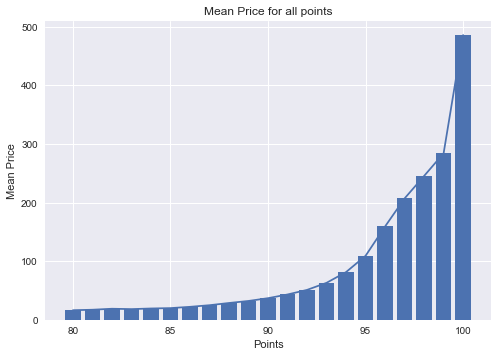

In [48]:
# Plot the relationship between points and price, without a doubt, you can say that the higher the point score of the wine, on average, the higher the price

plt.bar(range(80,101), mean_point_price)
plt.plot(range(80,101), mean_point_price)
plt.xlabel('Points')
plt.ylabel('Mean Price')
plt.title('Mean Price for all points')

## Data Cleaning

In [49]:
# Make a dataframe with all the variables I want to use in the model, explanatory, dependant and dummy variables
wine_model = wine[['points', 'price', 'country', 'variety']]

# 8996 instances of null price - likely that it was unrecorded by the reviewer, best to drop them, Small percent of total data.
wine_model[wine_model['price'].isnull()]
wine_model = wine_model.dropna()
wine_model = wine_model.reset_index(drop=True)

## Feature Engineering

In [50]:
# Finding top 6 wine producing countries
wine_model.country.value_counts()
wine_true_counts = wine_model.country.value_counts()[0:6].values
wine_model.variety.value_counts()[0:10]

Pinot Noir                  12785
Chardonnay                  11077
Cabernet Sauvignon           9384
Red Blend                    8466
Bordeaux-style Red Blend     5340
Riesling                     4971
Sauvignon Blanc              4780
Syrah                        4086
Rosé                         3261
Merlot                       3061
Name: variety, dtype: int64

In [119]:
# Setting columns default values to zero so when they are iterated upon by the next cell the relevant entries will be set to 1
wine_model['US'] = 0
wine_model['France'] = 0
wine_model['Italy'] = 0
wine_model['Spain'] = 0
wine_model['Portugal'] = 0
wine_model['Chile'] = 0
wine_model['Other_Country'] = 0
wine_model['Legend_Label'] = 0

In [120]:
# Iterate through the country column and generate dummy variables for the top 6 wine producing countries and assighing a 1 to all of the other countries
# I chose the top 6 to make the number of wines produced by Other_Countries a similar number to those produced by the top 6
for c in range(wine_model.index[0],wine_model.index[-1]+1):
    if wine_model['country'][c] == 'US':
        wine_model['US'][c] = 1
        wine_model['Legend_Label'][c] = 'US'
    elif wine_model['country'][c] == 'France':
        wine_model['France'][c] = 1
        wine_model['Legend_Label'][c] = 'France'
    elif wine_model['country'][c] == 'Italy':
        wine_model['Italy'][c] = 1
        wine_model['Legend_Label'][c] = 'Italy'
    elif wine_model['country'][c] == 'Spain':
        wine_model['Spain'][c] = 1
        wine_model['Legend_Label'][c] = 'Spain'
    elif wine_model['country'][c] == 'Portugal':
        wine_model['Portugal'][c] = 1
        wine_model['Legend_Label'][c] = 'Portugal'
    elif wine_model['country'][c] == 'Chile':
        wine_model['Chile'][c] = 1
        wine_model['Legend_Label'][c] = 'Chile'
    else:
        wine_model['Other_Country'][c] = 1
        wine_model['Legend_Label'][c] = 'Other_Country'

In [121]:
# Testing that any unassigned country values haven't slipped by
top_wine_countries = ['US','France','Italy','Spain','Portugal','Chile','Other_Country']
wine_dummy_sums = [wine_model[top_wine_countries[d]].sum() for d in range(0,7)]
# Ranged 0:6 because 'Other_Country' is not a country in the wine_true_counts list
wine_dummy_sums[0:6] == wine_true_counts[0:6]
# Since it returned 6 trues, we can assume that the number of wines Other_Countries matches those omitted from wine_true_counts

array([ True,  True,  True,  True,  True,  True])

In [122]:
# --Generate Dummy Variables Of Qualitative Descriptors
# --Would making dummy variables out of Country, Repeted Descriptors eg 'fruity' 'tropical', Variety & Winery add value to the model?
# --After exploring, I found no reason to add Winery as a dummy variable, at most, one winery produces some 230 wines out of the hundred thousand which 
#   wouldn't amount to much of a relationship given that the majority of wineries only produce a handfull of wines
# --After adding the length of description to the models as a proxy for how complexity of flavour affects price, assuming that a small descriptions would 
#   imply no distinct flavour, mid length descriptions being flavourful but not complex, and long descriptions requiring a trained tongue to understand 
#   and appreciate
#   I found that, while len_desc was significant in the OLS regression with a t= 9.289, the relating coeff was very small with a value of 0.0187
#   This increased the neg_mean_abs_err for all models so I removed len_desc from the model. 
wine_dummies = wine_model[['price','points','US','France','Italy','Spain','Portugal','Chile','Other_Country']]
wine_dummies.head()

# -- Prior to iterating through the country column and setting dummies using conditional statements, I used wine_model.get_dummies() however
#    this caused the cross validation score of the linear regressions to be very large and inflated the score of the random forest.
#    Due to this, I opted to only use the top 6 countries since they produce the majority of wines and classify all other countries as 'Other_Country'

,price,points,US,France,Italy,Spain,Portugal,Chile,Other_Country
0,15.0,87,0,0,0,0,1,0,0
1,14.0,87,1,0,0,0,0,0,0
2,13.0,87,1,0,0,0,0,0,0
3,65.0,87,1,0,0,0,0,0,0
4,15.0,87,0,0,0,1,0,0,0


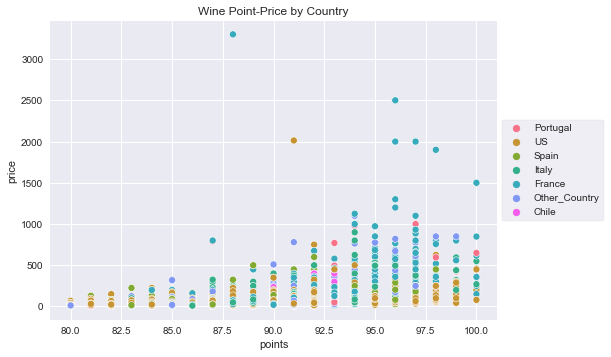

In [132]:
sns.scatterplot(x= wine_dummies.points, y= wine_dummies.price, hue= wine_model.Legend_Label)
plt.legend(bbox_to_anchor=(1.24, .5), ncol=1, loc='center right', borderaxespad=0., frameon= True)
plt.title('Wine Point-Price by Country')
plt.show()

<AxesSubplot:xlabel='points', ylabel='price'>

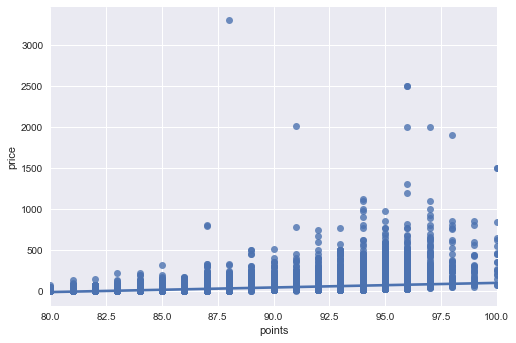

In [78]:
# --the regression plot shows a slight positive relationship between points and price and, while there are some outliers, their effect is minimal due to
# the density of the data that follows the trend
sns.regplot(x= wine_model.points, y= wine_model.price)

## Modeling

In [48]:
# Model the relationship between points and price including the dummy variables for all qualitative descriptors
# Importing Sci Kit Learn and making Test Splits and validating/tuning for Model Building.
from sklearn.model_selection import train_test_split, cross_val_score, RandomizedSearchCV
x = wine_dummies.drop('price', axis=1)
x_nd = wine_dummies['points'].values
y = wine_dummies['price'].values
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size= 0.5, random_state=0)
x_train_nd, x_test_nd, y_train_nd, y_test_nd = train_test_split(x_nd, y, test_size= 0.5, random_state=0)

In [36]:
# Statsmodels OLS Linear Multiple Regression
import statsmodels.api as sm
# Setting constant value to centre the regression
x_sm = x = sm.add_constant(x)

model = sm.OLS(y, x_sm)
results = model.fit()
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.180
Model:                            OLS   Adj. R-squared:                  0.180
Method:                 Least Squares   F-statistic:                     3785.
Date:                Fri, 08 Jan 2021   Prob (F-statistic):               0.00
Time:                        15:42:58   Log-Likelihood:            -6.0871e+05
No. Observations:              120915   AIC:                         1.217e+06
Df Residuals:                  120907   BIC:                         1.218e+06
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const          -398.6546      2.742   -145.367

In [37]:
# SK learn linear multiple regression modeling and scoring
from sklearn.linear_model import LinearRegression
import sklearn.metrics as metrics


def regression_results(y_true, y_pred):

    # Regression metrics
    explained_variance=metrics.explained_variance_score(y_true, y_pred)
    mean_absolute_error=metrics.mean_absolute_error(y_true, y_pred) 
    mse=metrics.mean_squared_error(y_true, y_pred) 
    median_absolute_error=metrics.median_absolute_error(y_true, y_pred)
    r2=metrics.r2_score(y_true, y_pred)

    print('explained_variance: ', round(explained_variance,4))    
    print('r2: ', round(r2,4))
    print('MAE: ', round(mean_absolute_error,4))
    print('MSE: ', round(mse,4))
    print('RMSE: ', round(np.sqrt(mse),4))


ols = LinearRegression()
ols.fit(x_train, y_train)

expected = y_test
predicted = ols.predict(x_test)

print(regression_results(expected, predicted)) 
print(f'Average Cross Val neg_mean_abs_err: {np.mean(cross_val_score(ols, x_train, y_train, scoring="neg_mean_absolute_error", cv= 5))}')

explained_variance:  0.1615
r2:  0.1615
MAE:  16.972
MSE:  1577.7111
RMSE:  39.7204
None
Average Cross Val neg_mean_abs_err: -16.88191139543437


In [40]:
# Random search to find best estimators for linear model and running the random search
params= {}
rand_search_ols = RandomizedSearchCV(ols, params, random_state= 1, cv= 5, verbose= 2)

In [41]:
ols.get_params().keys()

dict_keys(['copy_X', 'fit_intercept', 'n_jobs', 'normalize', 'positive'])

In [176]:
fit_rand_search_ols = rand_search_ols.fit(x_train, y_train)
round(fit_rand_search_ols.best_score_,4)

Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV] END .................................................... total time=   0.0s
[CV] END .................................................... total time=   0.0s
[CV] END .................................................... total time=   0.0s
[CV] END .................................................... total time=   0.0s
[CV] END .................................................... total time=   0.0s


0.2074

In [177]:
rand_estimated = y_test
rand_predicted = fit_rand_search_ols.predict(x_test)

print(regression_results(rand_estimated, rand_predicted)) 

print(rand_estimated)
print(rand_predicted)

explained_variance:  0.1615
r2:  0.1615
MAE:  16.972
MSE:  1577.7111
RMSE:  39.7204
None
[25. 15. 19. ... 15. 48. 22.]
[42.26586914 18.68945312 31.28710938 ... 36.92138672 44.47460938
 22.32128906]


## Evaluation And Critique

As is shown in the above few cells, using a random search on the ols regression had no affect on the measures of performance. Interesting to note is that, the main difference between the Statsmodel and Sklearn ols model is how they handle the setting of the y-intercept. In the stats models regression I manually set the constant to x whereas Sklearn calculates the intercept by default unless otherwise marked, while the difference in the success of the models doesn't vary much, a 1.5% equivalent difference between the 2 ways of generating and OLS regression. Both models are objectively poor at predicting price from points and my set of dummy variables. This indicates that the model is likely misspecified and would benefit from a nonlinear model. Spesifically, I think the model could be improved if, instead of using a linear model, the model was non linear and of power 2

In [73]:
# Comparing the linear model with dummy variables to one that just has the constant and points values.
# Have to reshape data since sklearn won't take a 1-D array for it's dependant variale

ols_nd = LinearRegression()
ols_nd.fit(x_train_nd.reshape(-1, 1), y_train_nd)

expected_nd = y_test_nd
predicted_nd = ols_nd.predict(x_test_nd.reshape(-1, 1))

print(regression_results(expected_nd, predicted_nd)) 

explained_variance:  0.1561
r2:  0.1561
MAE:  17.0771
MSE:  1587.8566
RMSE:  39.8479
None


In [74]:
x_sm_nd = x_nd = sm.add_constant(x_nd)

model = sm.OLS(y, x_sm_nd)
results = model.fit()
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.173
Model:                            OLS   Adj. R-squared:                  0.173
Method:                 Least Squares   F-statistic:                 2.533e+04
Date:                Fri, 08 Jan 2021   Prob (F-statistic):               0.00
Time:                        16:41:19   Log-Likelihood:            -6.0919e+05
No. Observations:              120915   AIC:                         1.218e+06
Df Residuals:                  120913   BIC:                         1.218e+06
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       -460.5281      3.118   -147.723      0.0

In this instance, removing the dummy variables had a negative affect upon the explanatory power of the models. I would be interested to see if increasing the number of country dummy variables that the model used would increase their explanatory power

It is important to note that, despite the low explanatory power of the models, the dependant variables of both instances of the statsmodels models have high statistical significance suggesting that, while the model is poor, the variables themselves are not.